<img align="left" src = https://project.lsst.org/sites/default/files/Rubin-O-Logo_0.png width=250 style="padding: 10px"> 
<br>
<b>Explore Large Alerts</b> <br>
Contact author: Brianna Smart<br>
Last verified to run: -  01/10/2024<br>
LSST Science Piplines version: - Weekly 2024_01 Large Container<br>
Container Size: Large <br># Clean Notebook

## Table of Contents

1. [Introduction](#Introduction)
2. [Data](#Data)
3. [Conclusions](#Conclusions)
4. [Setup](#Setup)
5. [200 to 1000 pixel cutouts](#200-to-1000-pixel-cutouts)
6. [Cutout and Footprint Mismatch](#Cutout-and-Footprint-Mismatch)
7. [Explore Psf Dipole Flux Flags](#Explore-Psf-Dipole-Flux-Flags)
8. [Sources between 200 and 100 pixels](#Sources-between-200-and-100-pixels)
9. [Obvious cosmic rays](#Obvious-cosmic-rays)
10. [Sources between 100 and 50](#Sources-between-100-and-50-pixels)
   

## Too large cutouts in alerts

## Introduction

This notebook inspects a number of alert packets which contain alerts with cutouts that are unreasonably large. The minimum cutout size for an alert is 30 x 30 pixels, but there is no set maximum. We are seeing several cutouts of 200x200 pixels, and some even largr than 800x800. While these are being filtered out and not making it into the alert stream, they should not be making it to the database in the first place.

# Data

The data is from a Weekly 2024_01 ap_verify run using schema 6.0. Any alert that is too large to go to the alert stream is filtered out and saved to disk. With the current setup, it also saves the whole alert packet to disk, and we investigate all the alerts contained in it, not just the overly large alerts.

## Conclusions

Upon initial inspection, all of the cutouts that are far too large are obviously bad sources. Most appear on over saturated stars, bad columns. The few that appear to have "normal" cutouts have incorrectly centered cutouts, where the dipole centroid the cutout is based on is far outside of the footprint. Upon inspecting the footprint itself, you can see that the source was detected on bad columns. 

In addition to the dipole centroids being far apart, all of these sources have the interpolated flag set. While this doesn't necessarily mean that the sources are bad, looking at a large subset of sources with the interpolated flag might be a good idea to see if any with the flag set are good. 

Other bad sources, such as source 25397859608167394, are abnormally long and straight. These are bad columns, but if we do additional filtering based on footprint size it's possible these would be filtered out. However, more discussion should be had about what it means to set a max footprint size. If a sources size is far beyond the footprint maximum, what does that mean for the alert itself? 

The current solution of not sending this alerts is not catching any legitimate images, and inspecting the large alerts after any major changing in filtering or algorithms will give us an idea of how well the pipeline is working.


## Setup

In [2]:
import os
import io
import gzip
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import importlib
from lsst.analysis.ap import apdb
from lsst.analysis.ap import legacyApdbUtils as utils
import fastavro

import lsst.geom
import lsst.daf.butler as dafButler
from lsst.ap.association import UnpackApdbFlags, TransformDiaSourceCatalogConfig
from lsst.analysis.ap import legacyApdbUtils as utils
from lsst.analysis.ap import legacyPlotUtils as plac
from lsst.analysis.ap import apdb

from astropy.time import Time
from astropy.io import fits
from astropy.nddata import CCDData
import lsst.afw.display as afwDisplay
from IPython.display import IFrame
import gc
%matplotlib inline

In [3]:
def m_and_v_plots (exposure, matplot=None, display_num=None, record=None):
    """
    Create an array of plots with their mask and variance

    Parameters
    ----------
    datasetRefs: a set of DataSetRefs
    returned by the butler
    matplot: Can be set to True
    display_num: Integer setting number of images

    Returns
    -------
    None
    """
    
    if display_num == None:
        display_num=1
    else:
        display_num=display_num
    
    if matplot != None:
        afwDisplay.setDefaultBackend('matplotlib') 
        
        print('Visit: ', exposure.visitInfo.getId(), ', Detector: ', exposure.detector.getId())
        fig, ax = plt.subplots(1, 3, figsize=(14, 7))
        plt.sca(ax[0])  # set the first axis as current
        plt.xlabel('Image with Mask Overlay')
        display1 = afwDisplay.Display(frame=fig)
        display1.scale('asinh', -1, 30)
        display1.mtv(exposure)
        plt.sca(ax[1])  # set the second axis as current
        display2 = afwDisplay.Display(frame=fig)
        display2.mtv(exposure.mask)
        plt.tight_layout()
        plt.sca(ax[2]) 
        display3 = afwDisplay.Display(frame=fig)
        display3.scale('asinh', 'zscale')
        display3.mtv(exposure.variance)
        plt.tight_layout()
        plt.show()
        remove_figure(fig)

    else:
        afwDisplay.setDefaultBackend('firefly')

        print('Visit: ', exposure.visitInfo.getId(), ', Detector: ',exposure.detector.getId())
        display = afwDisplay.Display(frame=0)
        display.scale('asinh', -1, 30)
        display.mtv(exposure)
        display = afwDisplay.Display(frame=1)
        display.setMaskTransparency(90)
        display.mtv(exposure.mask)
        display = afwDisplay.Display(frame=2)
        display.scale('asinh', 'zscale')
        display.mtv(exposure.variance)

    if record is not None:
        display1.dot('x', record.getX(),record.getY())
        display2.dot('x', record.getX(),record.getY())
        display3.dot('x', record.getX(),record.getY())

In [4]:
def remove_figure(fig):
    """
    Remove a figure to reduce memory footprint.

    Parameters
    ----------
    fig: matplotlib.figure.Figure
        Figure to be removed.

    Returns
    -------
    None
    """
    # get the axes and clear their images
    for ax in fig.get_axes():
        for im in ax.get_images():
            im.remove()
    fig.clf()       # clear the figure
    plt.close(fig)  # close the figure
    gc.collect()    # call the garbage collector

In [5]:
def find_files(root_dir):
    for dir_name, subdir_list, file_list in os.walk(root_dir, followlinks=True):
        for fname in file_list:
            if fname.endswith('.avro'):
                yield dir_name+'/'+fname

In [6]:
def plot_stamps(filename, pixel_max=3200, pixel_min=200, sourceId = None, return_alert = False):
    # Can take a single sourceId or look at all of them for a range of pixel dimensions. Can also return the packet if 
    with open(filename,'rb') as f:
        try:
            freader = fastavro.reader(f)
            for packet in freader:
                image_data = packet['cutoutDifference']
                if sourceId is not None:
                    if packet['diaSource']['diaSourceId'] != sourceId:
                        continue
                    else:
                        print("source_found")
                        if return_alert: 
                            return packet
                with io.BytesIO(image_data) as bytesIO:
                    cutoutFromBytes = CCDData.read(bytesIO, format="fits")
                bbox = cutoutFromBytes.shape
                if bbox[0] >=pixel_min and bbox[1] >= pixel_min and bbox[0] <= pixel_max and bbox[1] <= pixel_max:
                    plt.figure()
                    source = apdbQuery.load_source(packet['diaSource']['diaSourceId'])
                    dataId ={'detector':source['detector'],'visit': source['visit']}
                    catalog = butler.get(f'goodSeeingDiff_diaSrc', dataId)
                    record = catalog.find(packet['diaSource']['diaSourceId'])
                    print('-----------------------------------------------')
                    print(filename)
                    print("DiaSource Id: ", packet['diaSource']['diaSourceId'])
                    print("Bounding Box: ", bbox)
                    print("Centroid: ", record.getX(), record.getY())
                    print("Interpolated Flag: ", record['base_PixelFlags_flag_interpolated'])
                    print("Saturated Flag: ", record['base_PixelFlags_flag_saturated'])
                    print("Trailed Source Flag: ", record['ext_trailedSources_Naive_flag'])
                    length_check = record['ext_trailedSources_Naive_length']
                    print("Trailed Source Length more than limit: ", )
                    print("Dipole Flux Flag: ", record['ip_diffim_PsfDipoleFlux_flag'])
                    print("Dipole Flux Centroid: ", record['ip_diffim_NaiveDipoleCentroid_x'],record['ip_diffim_NaiveDipoleCentroid_y'])
                    x_dipole_sep=record['ip_diffim_NaiveDipoleCentroid_pos_x']-record['ip_diffim_NaiveDipoleCentroid_neg_x']
                    y_dipole_sep=record['ip_diffim_NaiveDipoleCentroid_pos_y']-record['ip_diffim_NaiveDipoleCentroid_neg_y']
                    print("Seperation of x and y dipole coords: ", [x_dipole_sep,y_dipole_sep])
                    plt.imshow(cutoutFromBytes, vmin=-1, vmax=30)
        except:
            out=1
            # print(filename + " not a data packet")
            #print("")

In [7]:
def plot_footprint(source, dataSetType):
    
    dataId ={'detector':source['detector'],'visit': source['visit']}
    calexp=butler.get(dataSetType, dataId)
    catalog = butler.get(f'goodSeeingDiff_diaSrc', dataId)
    record = catalog.find(source['diaSourceId'])
    footprint = record.getFootprint()
    cutout_calexp = calexp.subset(footprint.getBBox())
    print("Footprint bounding box: ", footprint.getBBox())
    print("Centroid from record = ", record.getX(), record.getY())
    print(record['ip_diffim_PsfDipoleFlux_flag'])
    m_and_v_plots(cutout_calexp, display_num=0, matplot=True, record=record)
    print(record)
    #print(footprint)


## Set Up Data

In [8]:
collection="ap_verify-output/20240110T180834Z"
butler = lsst.daf.butler.Butler("/sdf/group/rubin/u/smart/code/workspacest/postage_stamp_investigation/repo/", collections=collection)

apdbQuery = apdb.ApdbSqliteQuery("/sdf/group/rubin/u/smart/code/workspacest/postage_stamp_investigation/association.db", butler=butler, instrument="HSC")
sources = apdbQuery.load_sources( limit=100000)
objects = apdbQuery.load_objects()

In [9]:
source = sources.loc[0]

In [10]:
dataId ={'detector':source['detector'],'visit': source['visit']}
calexp=butler.get('calexp', dataId)
catalog = butler.get(f'goodSeeingDiff_diaSrc', dataId)
record = catalog.find(source['diaSourceId'])

In [11]:
xx=catalog.schema['id']

In [12]:
for field in catalog.schema:
    name = field.getField().getName()
    if "_flag" in name and record[name]:
        print(name, record[name])

base_NaiveCentroid_flag True
base_NaiveCentroid_flag_resetToPeak True
base_SdssCentroid_flag True
base_SdssCentroid_flag_notAtMaximum True
base_SdssCentroid_flag_near_edge True
base_SdssShape_flag True
base_SdssShape_flag_unweightedBad True
ext_shapeHSM_HsmSourceMoments_flag True
base_CircularApertureFlux_9_0_flag_sincCoeffsTruncated True
base_CircularApertureFlux_25_0_flag True
base_CircularApertureFlux_25_0_flag_apertureTruncated True
base_CircularApertureFlux_35_0_flag True
base_CircularApertureFlux_35_0_flag_apertureTruncated True
base_CircularApertureFlux_50_0_flag True
base_CircularApertureFlux_50_0_flag_apertureTruncated True
base_CircularApertureFlux_70_0_flag True
base_CircularApertureFlux_70_0_flag_apertureTruncated True
base_GaussianFlux_flag True
base_PixelFlags_flag_edge True
base_PixelFlags_flag_interpolated True
base_PixelFlags_flag_bad True
base_PixelFlags_flag_interpolatedCenter True
base_PixelFlags_flag_badCenter True
base_PixelFlags_flag_interpolatedCenterAll True
ba

In [13]:
print(catalog.schema['id'])

In [14]:
catalog.schema

Schema(
    (Field['L'](name="id", doc="unique ID"), Key<L>(offset=0, nElements=1)),
    (Field['Angle'](name="coord_ra", doc="position in ra/dec"), Key<Angle>(offset=8, nElements=1)),
    (Field['Angle'](name="coord_dec", doc="position in ra/dec"), Key<Angle>(offset=16, nElements=1)),
    (Field['L'](name="parent", doc="unique ID of parent source"), Key<L>(offset=24, nElements=1)),
    (Field['F'](name="coord_raErr", doc="1-sigma uncertainty on ra", units="rad"), Key<F>(offset=32, nElements=1)),
    (Field['F'](name="coord_decErr", doc="1-sigma uncertainty on dec", units="rad"), Key<F>(offset=36, nElements=1)),
    (Field['F'](name="coord_ra_dec_Cov", doc="uncertainty covariance between ra and dec", units="rad rad"), Key<F>(offset=40, nElements=1)),
    (Field['Flag'](name="flags_negative", doc="set if source was detected as significantly negative"), Key['Flag'](offset=48, bit=0)),
    (Field['D'](name="base_NaiveCentroid_x", doc="centroid from Naive Centroid algorithm", units="pixel"

## 200 to 1000 pixel cutouts

These are all the alerts with a cutout larger than 200 by 200 pixels. We see that every one of these is a bad source, and identified a few sources we wanted to look at closer, such as source 25409118864933814.

Future changes to the pipeline will likely remove many of these sources from the catalog so they do not reach the alerts.

-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101636
Bounding Box:  (286, 286)
Centroid:  503.0114873520232 179.02175299198856
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  True
Dipole Flux Centroid:  503.0114873520232 179.02175299198856
Seperation of x and y dipole coords:  [49.962738037109375, -103.3310775756836]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101650
Bounding Box:  (230, 230)
Centroid:  1113.3542779400866 490.2660928419115
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  True
Dipole Flux Centroid:  1113.3542779400866 490.2660928419115
Seperation of x and y dipole coords:  [-8.263183593

/tmp/ipykernel_5797/754947270.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11830058.avro
DiaSource Id:  25404856109892044
Bounding Box:  (223, 223)
Centroid:  2016.9906793474295 1268.8077341043213
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  2016.9906793474295 1268.8077341043213
Seperation of x and y dipole coords:  [0.0013427734375, -14.111083984375]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11830058.avro
DiaSource Id:  25404856109892112
Bounding Box:  (210, 210)
Centroid:  1141.796630859375 2706.879150390625
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1141.796630859375 2706.879150390625
Seperation of x and y dipole coords:  [nan, nan]
----

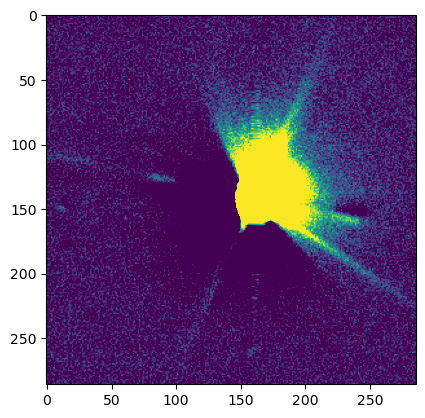

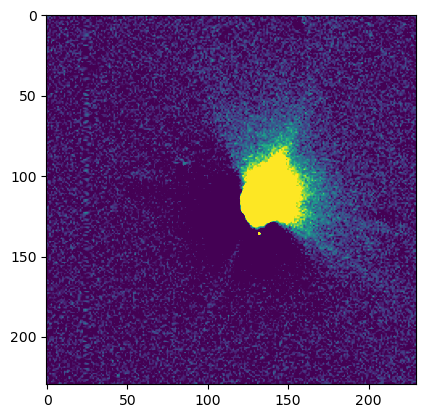

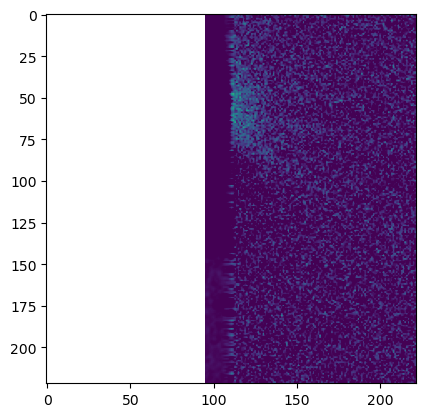

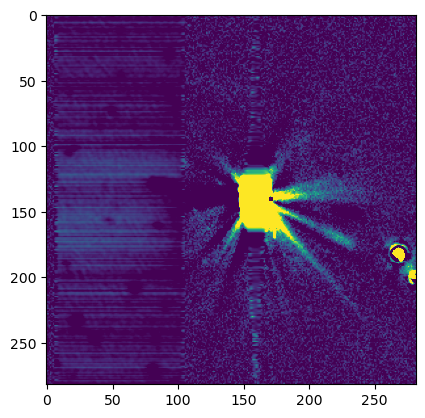

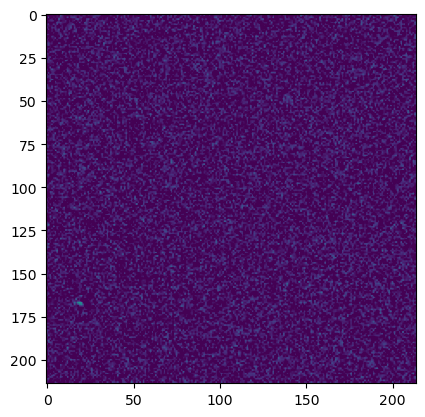

...

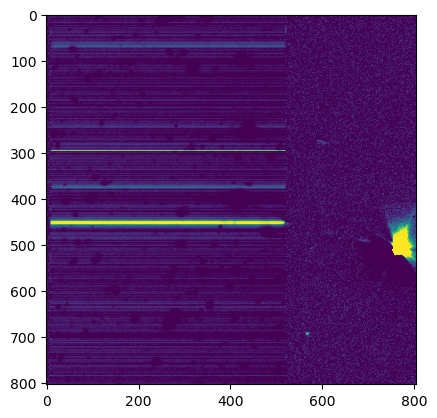

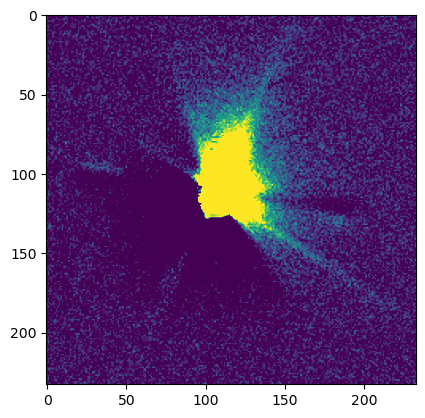

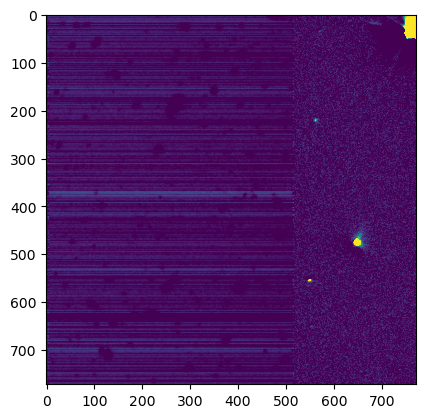

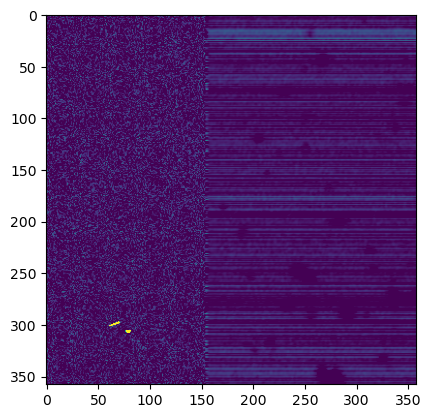

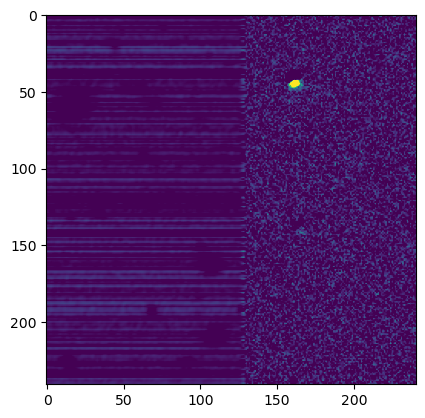

In [16]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            plot_stamps(next(files_gen), 1000,200, sourceId=None)
        except StopIteration:
            break

## Cutout and Footprint Mismatch

Source 25409118864933814 from ap_verify has a postage stamp which is very different from the footprint. We explored looked at this source and its records to determine why the postage stamp and the footprint are so different. We saw that the postage stamp is based on the dipole peak, and the footprint is not. In this case, the dipole peaks are very far apart and far outside the footprint, leading to a postage stamp that is completely unrelated to the source itself.

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832043.avro
DiaSource Id:  25409118864933814
Bounding Box:  (214, 214)
Centroid:  1600.6063086766635 1941.9561393177312
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  True
Dipole Flux Centroid:  1600.6063086766635 1941.9561393177312
Seperation of x and y dipole coords:  [-1008.978515625, 90.1041259765625]


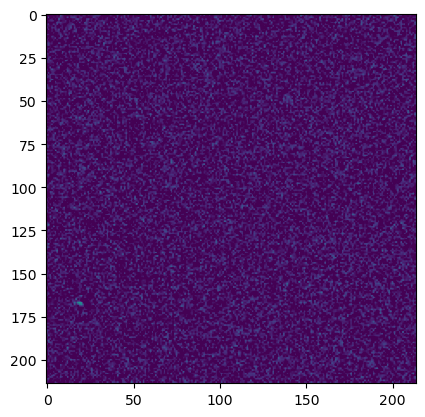

In [17]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            test= plot_stamps(next(files_gen), 1000,100, sourceId=25409118864933814)
        except StopIteration:
            break

In [18]:
diaSourceId = 25409118864933814
source= apdbQuery.load_source(diaSourceId)

Footprint bounding box:  (minimum=(973, 1959), maximum=(1079, 2012))
Centroid from record =  1600.6063086766635 1941.9561393177312
True
Visit:  59160 , Detector:  43


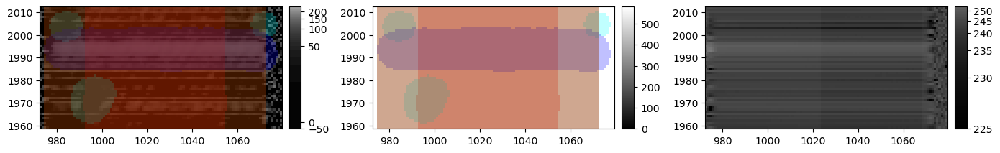

id: 25409118864933814
coord_ra: 2.61556 rad
coord_dec: 0.0385094 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 1017
base_NaiveCentroid_y: 1994
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 1017
base_PeakCentroid_y: 1994
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 1600.61
base_SdssCentroid_y: 1941.96
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 1600.61
ip

In [19]:
plot_footprint(source, 'goodSeeingDiff_differenceExp')

When looking aty the contents of the source, we noticed that there is a significant difference between the dipole centroid and where the footprint is centered. This is very obvious when looking at the footprint vs the cutout that makes it into the alerts. The footprint is based on the peak centroid, whereas the cutout is based on the dipole centroid. In this case, the dipole centroid is far outside the footprint. This is possibly due to the positive and negative dipole centroids being far apart, as can be seen in the seperation measured above.

In [20]:
record

<class 'lsst.afw.table.SourceRecord'>
id: 25397859608167206
coord_ra: 2.61223 rad
coord_dec: 0.0389549 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 640
base_NaiveCentroid_y: 19
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 640
base_PeakCentroid_y: 19
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 630.984
base_SdssCentroid_y: 19.9875
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 1
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_N

In [21]:
calexp.mask[record.getX(), record.getY()]

261

In [22]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832043.avro'
packet = plot_stamps(packet_filename, 1000,200, sourceId=25409118864933814, return_alert=True)

source_found


In [23]:
image_data = packet['cutoutDifference']
with io.BytesIO(image_data) as bytesIO:
    cutoutFromBytes = CCDData.read(bytesIO, format="fits")

(array([  1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0., 

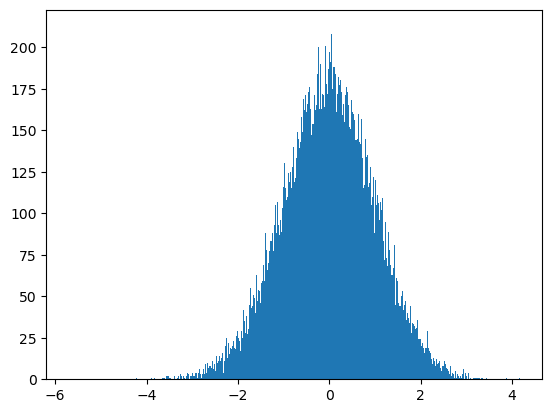

In [24]:
plt.hist((cutoutFromBytes.data/np.sqrt(cutoutFromBytes.uncertainty.array)).flat, bins=1000)

In [25]:
max((cutoutFromBytes.data/np.sqrt(cutoutFromBytes.uncertainty.array)).flat)

4.165746

In [26]:
min((cutoutFromBytes.data/np.sqrt(cutoutFromBytes.uncertainty.array)).flat)

-5.699145

## Explore Psf Dipole Flux Flags

On investigating the images which are too large, we noted that some of them have the PsfDipole flag set. We looked into if that was common amongst the large packets, but only X number have the flag set. Additionally, we noted some of the dipole negative and positive positions are at wildly different locations. This is not true across all overly large cutouts, though. After looking at source 25409118864933814, we thought to look at all the dipol flux flags and see if they are all set. Only 12 of the X sources with cutouts larger than 100 pixels in size did not have the dipole flag set. 

In [27]:
catalog['ip_diffim_PsfDipoleFlux_flag']

array([False, False, False, False, False, False, False, False, False,
       False,  True, False,  True, False, False, False, False, False,
       False, False,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False,  True, False,
       False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False,  True, False, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False,  True, False,
       False,  True, False, False, False, False, False, False, False,
        True, False,  True, False, False, False, False, False, False,
       False, False,

### Source 25397868198101671

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101671
Bounding Box:  (222, 222)
Centroid:  15.437384788256317 1167.877847676624
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  15.437384788256317 1167.877847676624
Seperation of x and y dipole coords:  [6.183385848999023, -83.93798828125]


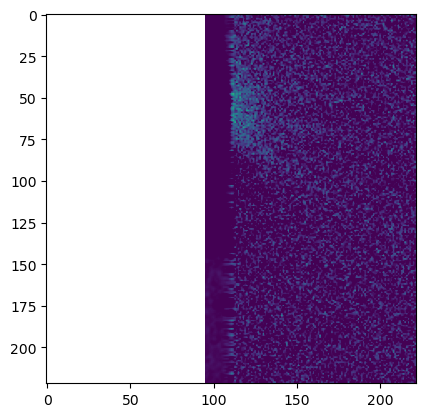

In [28]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            test= plot_stamps(next(files_gen), 1000,100, sourceId=25397868198101671)
        except StopIteration:
            break

Footprint bounding box:  (minimum=(7, 1057), maximum=(63, 1208))
Centroid from record =  15.437384788256317 1167.877847676624
False
Visit:  59134 , Detector:  4


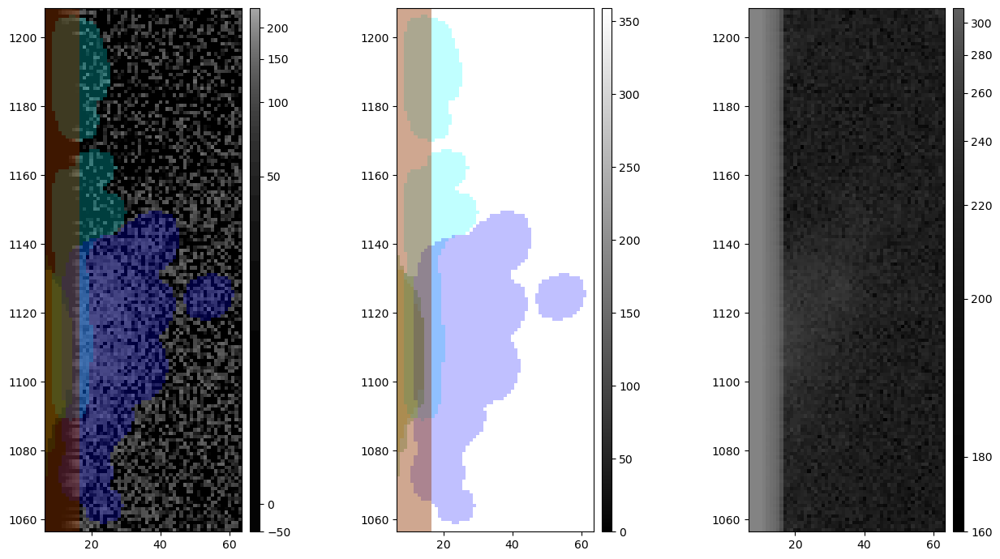

id: 25397868198101671
coord_ra: 2.61665 rad
coord_dec: 0.0402143 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 20
base_NaiveCentroid_y: 1106
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 20
base_PeakCentroid_y: 1106
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 15.4374
base_SdssCentroid_y: 1167.88
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 1
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 15.4374
ip_dif

In [29]:
source = apdbQuery.load_source(25397868198101671)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25401306319421687

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11828405.avro
DiaSource Id:  25401306319421687
Bounding Box:  (226, 226)
Centroid:  2031.9264521089888 768.149329395472
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  2031.9264521089888 768.149329395472
Seperation of x and y dipole coords:  [-3.2706298828125, 17.1558837890625]


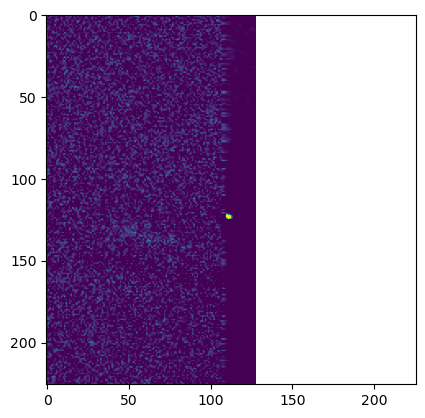

In [30]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            test= plot_stamps(next(files_gen), 1000,100, sourceId=25401306319421687)
        except StopIteration:
            break

Footprint bounding box:  (minimum=(1995, 739), maximum=(2040, 881))
Centroid from record =  2031.9264521089888 768.149329395472
False
Visit:  59142 , Detector:  5


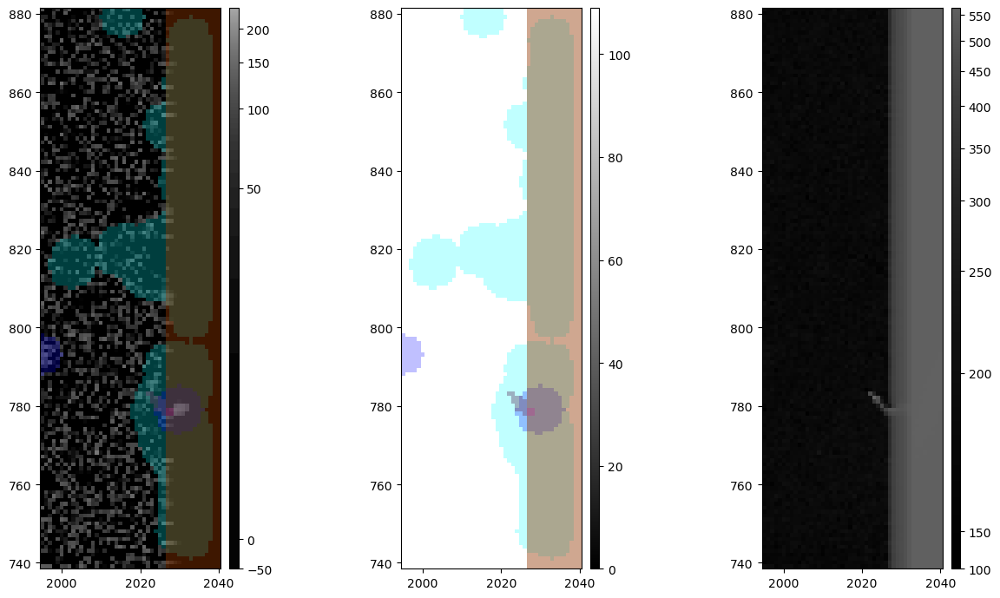

id: 25401306319421687
coord_ra: 2.61359 rad
coord_dec: 0.0409271 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 2030
base_NaiveCentroid_y: 779
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 2030
base_PeakCentroid_y: 779
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 2031.93
base_SdssCentroid_y: 768.149
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 1
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 2031.93
ip_d

In [31]:
source = apdbQuery.load_source(25401306319421687)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25401319204324351

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11828411.avro
DiaSource Id:  25401319204324351
Bounding Box:  (201, 201)
Centroid:  130.01235961914062 4161.18701171875
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  130.01235961914062 4161.18701171875
Seperation of x and y dipole coords:  [nan, nan]


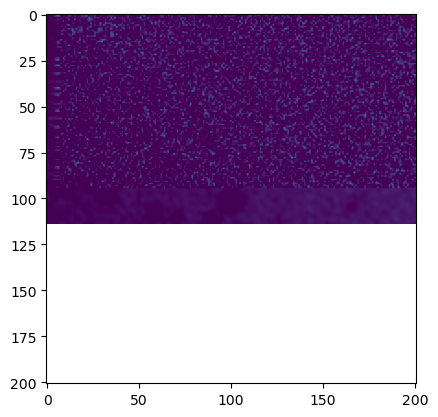

In [32]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11828411.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25401319204324351)

Footprint bounding box:  (minimum=(30, 4072), maximum=(152, 4168))
Centroid from record =  130.01235961914062 4161.18701171875
False
Visit:  59142 , Detector:  11


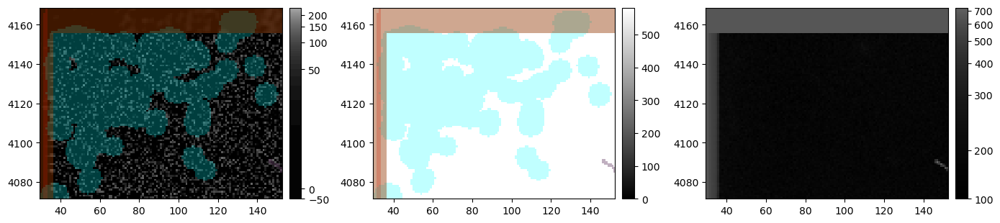

id: 25401319204324351
coord_ra: 2.61628 rad
coord_dec: 0.0411545 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 67
base_NaiveCentroid_y: 4098
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 67
base_PeakCentroid_y: 4098
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 130.012
base_SdssCentroid_y: 4161.19
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 1
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 130.012
ip_dif

In [33]:
source = apdbQuery.load_source(25401319204324351)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25404856109892044

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11830058.avro
DiaSource Id:  25404856109892044
Bounding Box:  (223, 223)
Centroid:  2016.9906793474295 1268.8077341043213
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  2016.9906793474295 1268.8077341043213
Seperation of x and y dipole coords:  [0.0013427734375, -14.111083984375]


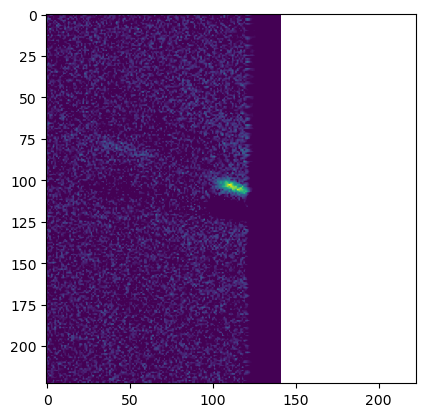

In [34]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11830058.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25404856109892044)

Footprint bounding box:  (minimum=(1993, 1209), maximum=(2040, 1380))
Centroid from record =  2016.9906793474295 1268.8077341043213
False
Visit:  59150 , Detector:  58


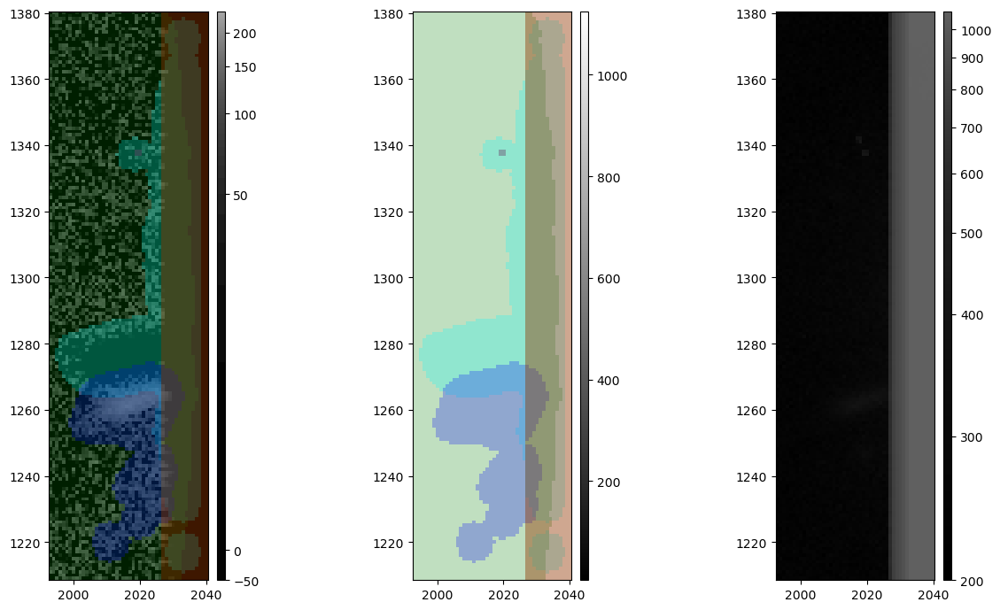

id: 25404856109892044
coord_ra: 2.61489 rad
coord_dec: 0.0412798 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 2017
base_NaiveCentroid_y: 1262
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 2017
base_PeakCentroid_y: 1262
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 2016.99
base_SdssCentroid_y: 1268.81
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 2016.99
ip

In [35]:
source = apdbQuery.load_source(25404856109892044)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25401295582004203

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11828400.avro
DiaSource Id:  25401295582004203
Bounding Box:  (212, 212)
Centroid:  619.9697875976562 1056.9822998046875
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  619.9697875976562 1056.9822998046875
Seperation of x and y dipole coords:  [nan, nan]


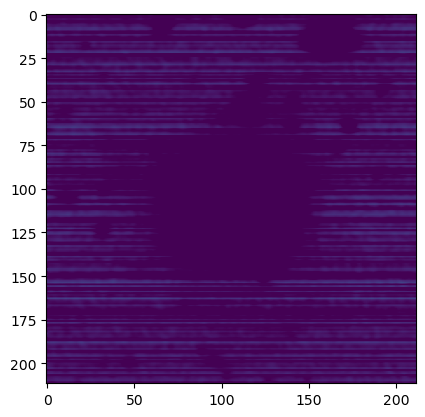

In [36]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11828400.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25401295582004203)

Footprint bounding box:  (minimum=(514, 980), maximum=(698, 1117))
Centroid from record =  619.9697875976562 1056.9822998046875
False
Visit:  59142 , Detector:  0


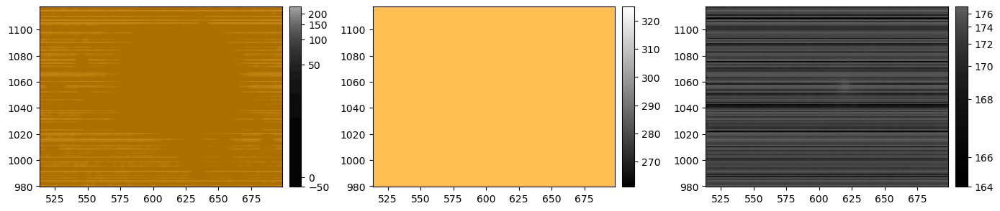

id: 25401295582004203
coord_ra: 2.61377 rad
coord_dec: 0.0382361 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 535
base_NaiveCentroid_y: 1042
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 535
base_PeakCentroid_y: 1042
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 619.97
base_SdssCentroid_y: 1056.98
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 619.97
ip_dif

In [37]:
source = apdbQuery.load_source(25401295582004203)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25397859608167286

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro
DiaSource Id:  25397859608167286
Bounding Box:  (336, 336)
Centroid:  717.280105166419 690.7738737577785
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  717.280105166419 690.7738737577785
Seperation of x and y dipole coords:  [14.00238037109375, 3.76751708984375]


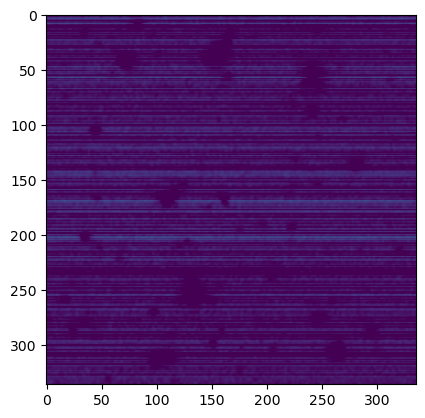

In [38]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25397859608167286)


Footprint bounding box:  (minimum=(701, 679), maximum=(885, 702))
Centroid from record =  717.280105166419 690.7738737577785
False
Visit:  59134 , Detector:  0


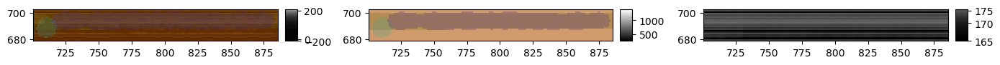

id: 25397859608167286
coord_ra: 2.61276 rad
coord_dec: 0.0390301 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 725
base_NaiveCentroid_y: 693
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 725
base_PeakCentroid_y: 693
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 717.28
base_SdssCentroid_y: 690.774
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 717.28
ip_diffi

In [39]:
source = apdbQuery.load_source(25397859608167286)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25397859608167286

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro
DiaSource Id:  25397859608167289
Bounding Box:  (406, 406)
Centroid:  880.8152507455906 717.4305106742468
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  880.8152507455906 717.4305106742468
Seperation of x and y dipole coords:  [-60.0009765625, 10.74395751953125]


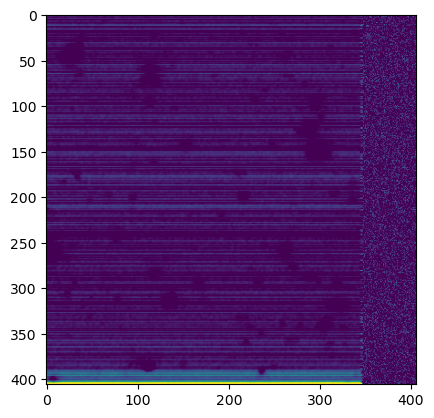

In [40]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25397859608167289)


Footprint bounding box:  (minimum=(678, 703), maximum=(947, 734))
Centroid from record =  880.8152507455906 717.4305106742468
False
Visit:  59134 , Detector:  0


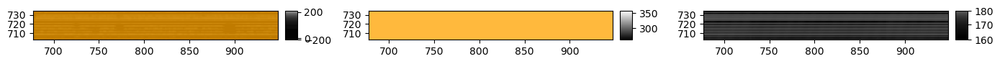

id: 25397859608167289
coord_ra: 2.61278 rad
coord_dec: 0.0391529 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 834
base_NaiveCentroid_y: 726
base_NaiveCentroid_flag: 1
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 1
base_PeakCentroid_x: 834
base_PeakCentroid_y: 726
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 880.815
base_SdssCentroid_y: 717.431
base_SdssCentroid_xErr: nan
base_SdssCentroid_yErr: nan
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 1
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 880.815
ip_dif

In [41]:
source = apdbQuery.load_source(25397859608167289)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25397859608167394

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro
DiaSource Id:  25397859608167394
Bounding Box:  (230, 230)
Centroid:  585.00439453125 1847.1932373046875
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  585.00439453125 1847.1932373046875
Seperation of x and y dipole coords:  [nan, nan]


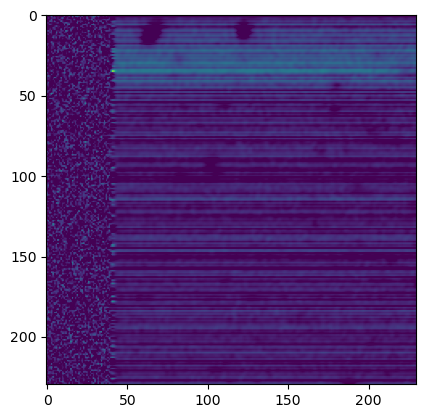

In [42]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25397859608167394)

Footprint bounding box:  (minimum=(506, 1838), maximum=(700, 1856))
Centroid from record =  585.00439453125 1847.1932373046875
False
Visit:  59134 , Detector:  0


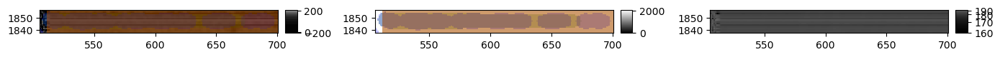

id: 25397859608167394
coord_ra: 2.61367 rad
coord_dec: 0.0389536 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 585.004
base_NaiveCentroid_y: 1847.19
base_NaiveCentroid_flag: 0
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 0
base_PeakCentroid_x: 585
base_PeakCentroid_y: 1847
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 585
base_SdssCentroid_y: 1847
base_SdssCentroid_xErr: 81.341
base_SdssCentroid_yErr: 0.59755
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 0
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 1
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 585.0

In [43]:
source = apdbQuery.load_source(25397859608167394)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Source 25397859608167400

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro
DiaSource Id:  25397859608167400
Bounding Box:  (251, 251)
Centroid:  527.9683227539062 1871.9288330078125
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  527.9683227539062 1871.9288330078125
Seperation of x and y dipole coords:  [nan, nan]


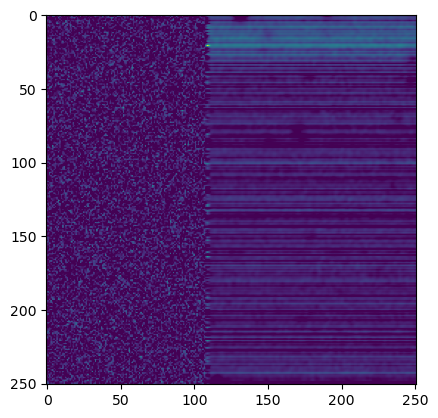

In [44]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826800.avro'
plot_stamps(packet_filename, 1000,200, sourceId=25397859608167400)

Footprint bounding box:  (minimum=(517, 1864), maximum=(653, 1880))
Centroid from record =  527.9683227539062 1871.9288330078125
False
Visit:  59134 , Detector:  0


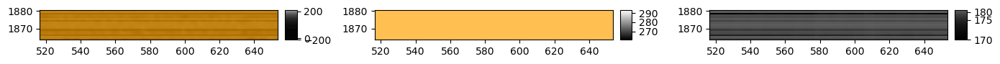

id: 25397859608167400
coord_ra: 2.61368 rad
coord_dec: 0.0389117 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 527.01
base_NaiveCentroid_y: 1871.09
base_NaiveCentroid_flag: 0
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 0
base_PeakCentroid_x: 528
base_PeakCentroid_y: 1872
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 528
base_SdssCentroid_y: 1872
base_SdssCentroid_xErr: 15.0069
base_SdssCentroid_yErr: 1.01431
base_SdssCentroid_flag: 1
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 0
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 1
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentroid_x: 527.9

In [45]:
source = apdbQuery.load_source(25397859608167400)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

## Sources between 200 and 100 pixels

Looking at sources between 200 and 100 pixels in size. All sources with a bbox above 200 pixels are interpolated. Between 200 and 100 pixels, 28 are interpolated. A look at these shows that the sources again are over saturated, on bad columns, or have cosmic rays which have been misidentified. The cosmic ray inclusion is from sources in the vignetted regions of the detector, and thus are not properly removed from the image. This is a known problem due to the larg vignetted regions in the HSC dataset and the poor psf fitting in these regions.

-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101654
Bounding Box:  (131, 131)
Centroid:  30.147269623380314 676.1139879154503
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  True
Dipole Flux Centroid:  30.147269623380314 676.1139879154503
Seperation of x and y dipole coords:  [-0.7941875457763672, -17.0570068359375]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101741
Bounding Box:  (115, 115)
Centroid:  380.2828063964844 2328.81591796875
Interpolated Flag:  False
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  380.2828063964844 2328.81591796875
Seperation of x and y dipole coords:  [nan, nan]
---

/tmp/ipykernel_5797/754947270.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832043.avro
DiaSource Id:  25409118864933986
Bounding Box:  (192, 192)
Centroid:  1062.7186743692685 3532.1686045302713
Interpolated Flag:  True
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1062.7186743692685 3532.1686045302713
Seperation of x and y dipole coords:  [1.938720703125, 9.327880859375]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832051.avro
DiaSource Id:  25409136044802512
Bounding Box:  (108, 108)
Centroid:  1569.2849997036944 2834.809558631358
Interpolated Flag:  True
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1569.2849997036944 2834.809558631358
Seperation of x and y dipole coords:  [17.684326171875

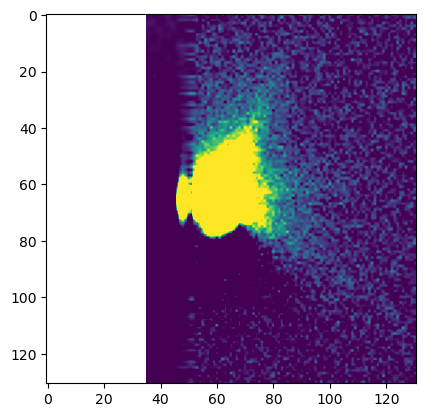

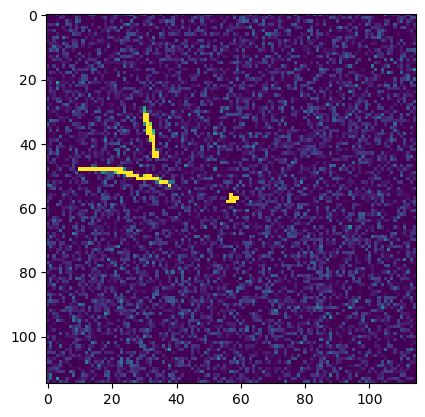

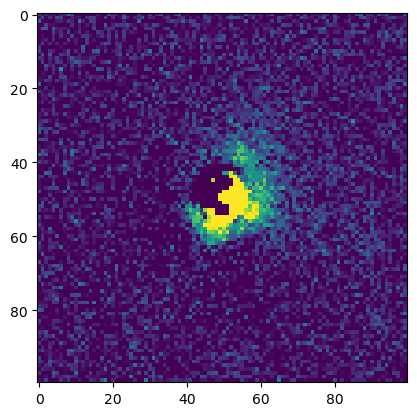

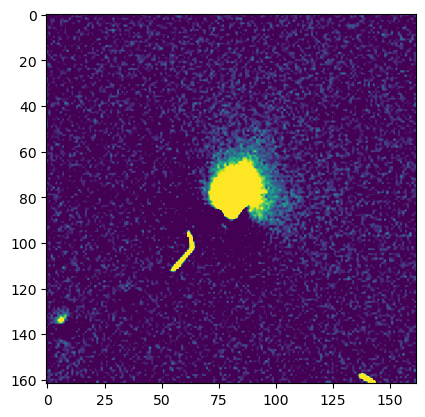

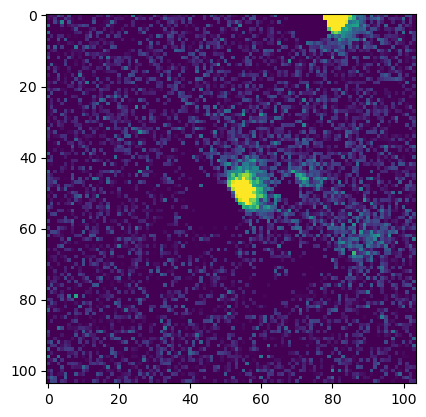

...

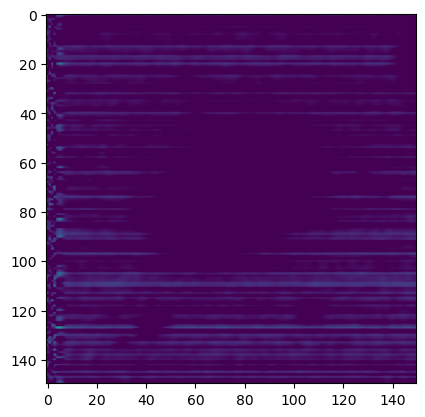

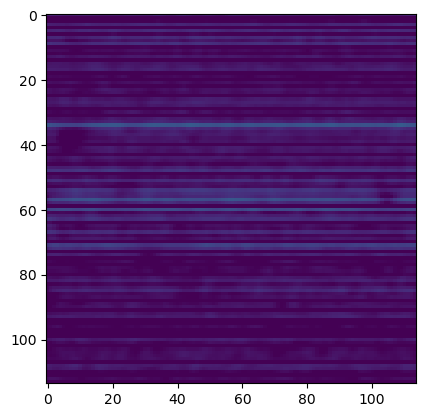

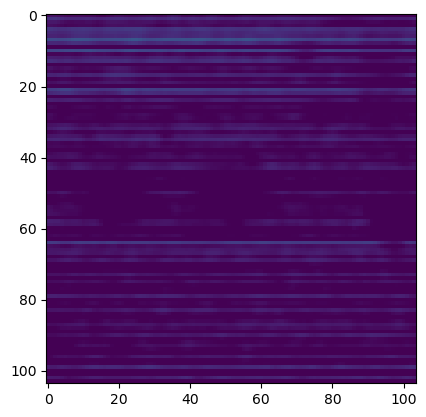

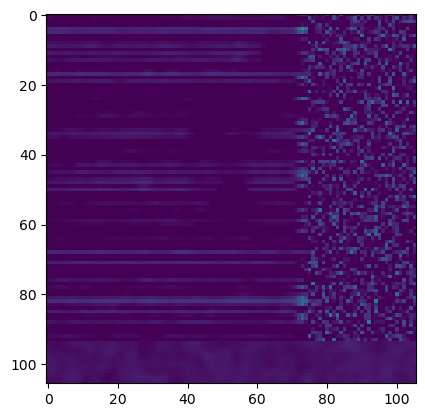

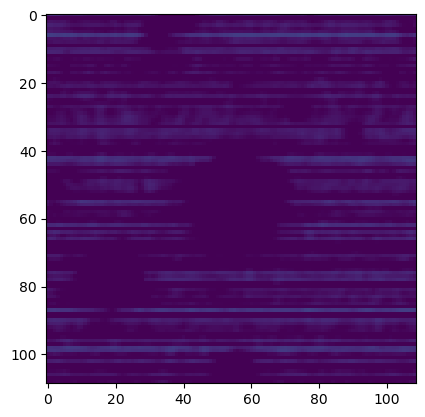

<Figure size 640x480 with 0 Axes>

In [46]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            plot_stamps(next(files_gen), 200,100, sourceId=None)
        except StopIteration:
            break

### Obvious cosmic rays

source_found
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101741
Bounding Box:  (115, 115)
Centroid:  380.2828063964844 2328.81591796875
Interpolated Flag:  False
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  380.2828063964844 2328.81591796875
Seperation of x and y dipole coords:  [nan, nan]


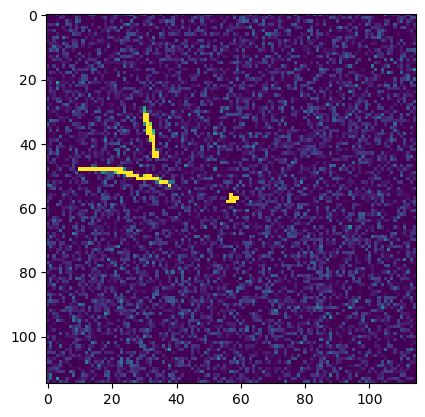

In [47]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro'
plot_stamps(packet_filename, 1000,0, sourceId=25397868198101741)

Footprint bounding box:  (minimum=(323, 2293), maximum=(393, 2341))
Centroid from record =  380.2828063964844 2328.81591796875
False
Visit:  59134 , Detector:  4


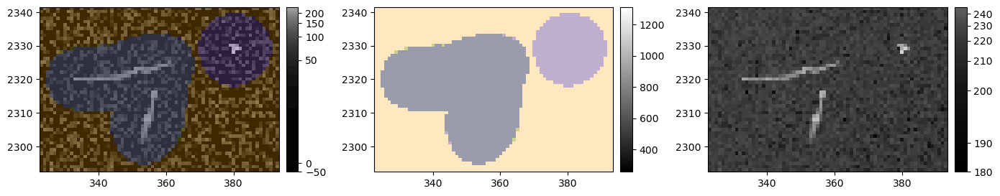

id: 25397868198101741
coord_ra: 2.61755 rad
coord_dec: 0.040525 rad
parent: 0
coord_raErr: nan
coord_decErr: nan
coord_ra_dec_Cov: nan
flags_negative: 0
base_NaiveCentroid_x: 380.412
base_NaiveCentroid_y: 2328.54
base_NaiveCentroid_flag: 0
base_NaiveCentroid_flag_noCounts: 0
base_NaiveCentroid_flag_edge: 0
base_NaiveCentroid_flag_resetToPeak: 0
base_PeakCentroid_x: 380
base_PeakCentroid_y: 2329
base_PeakCentroid_flag: 0
base_SdssCentroid_x: 380.377
base_SdssCentroid_y: 2328.77
base_SdssCentroid_xErr: 0.0134711
base_SdssCentroid_yErr: 0.0153137
base_SdssCentroid_flag: 0
base_SdssCentroid_flag_edge: 0
base_SdssCentroid_flag_noSecondDerivative: 0
base_SdssCentroid_flag_almostNoSecondDerivative: 0
base_SdssCentroid_flag_notAtMaximum: 0
base_SdssCentroid_flag_near_edge: 0
base_SdssCentroid_flag_resetToPeak: 0
base_SdssCentroid_flag_badError: 0
ip_diffim_NaiveDipoleCentroid_flag: 0
ip_diffim_NaiveDipoleCentroid_pos_flag: 0
ip_diffim_NaiveDipoleCentroid_neg_flag: 0
ip_diffim_NaiveDipoleCentro

In [48]:
source = apdbQuery.load_source(25397868198101741)
plot_footprint(source, 'goodSeeingDiff_differenceExp')

### Sources between 100 and 50

In this section we look at all alerts with cutouts between 50 and 100 pixels in size. Like the larger alerts, maybe of them appear to be bad columns, saturated, and/or cosmic rays from vignetted regions. However, in this region, there are several cutouts which might contain real sources. Unlike the prior ranges, a strict size cutoff would potentially remove real sources.

-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101612
Bounding Box:  (98, 98)
Centroid:  1788.8009980778897 18.774761983149954
Interpolated Flag:  False
Saturated Flag:  True
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1788.8009980778897 18.774761983149954
Seperation of x and y dipole coords:  [5.6572265625, 4.7216339111328125]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101617
Bounding Box:  (71, 71)
Centroid:  1997.0915924160868 69.33007083434822
Interpolated Flag:  False
Saturated Flag:  False
Trailed Source Flag:  False
Trailed Source Length more than limit: 
Dipole Flux Flag:  True
Dipole Flux Centroid:  1997.0915924160868 69.33007083434822
Seperation of x and y dipole coords:  [25.895263671875

/tmp/ipykernel_5797/754947270.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101885
Bounding Box:  (62, 62)
Centroid:  1155.617431640625 3405.2294921875
Interpolated Flag:  False
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1155.617431640625 3405.2294921875
Seperation of x and y dipole coords:  [nan, nan]
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11826804.avro
DiaSource Id:  25397868198101904
Bounding Box:  (75, 75)
Centroid:  1995.1298828125 3448.7314453125
Interpolated Flag:  False
Saturated Flag:  False
Trailed Source Flag:  True
Trailed Source Length more than limit: 
Dipole Flux Flag:  False
Dipole Flux Centroid:  1995.1298828125 3448.7314453125
Seperation of x and y dipole coords:  [nan, nan]
----------------------------------------------

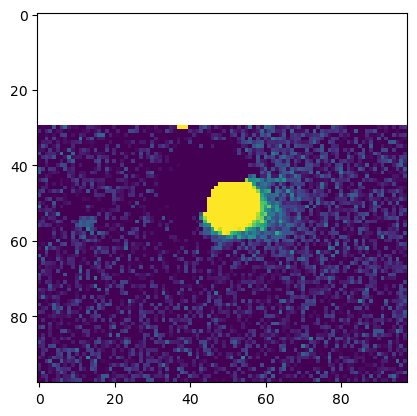

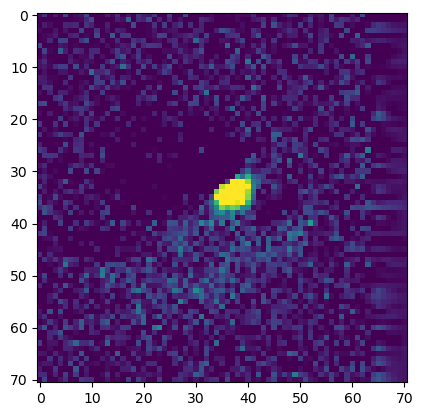

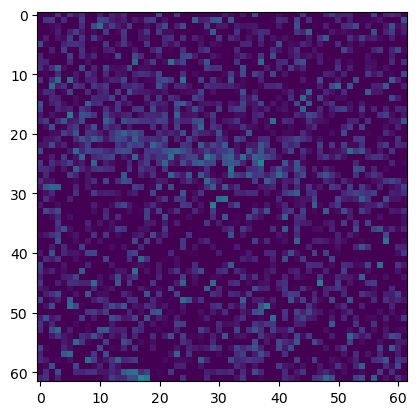

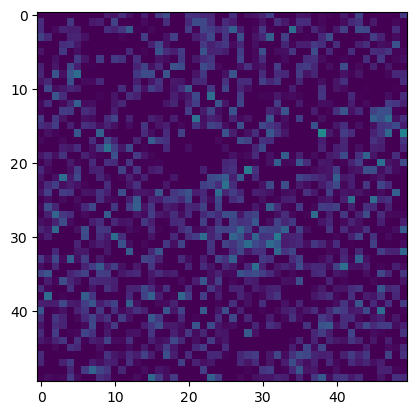

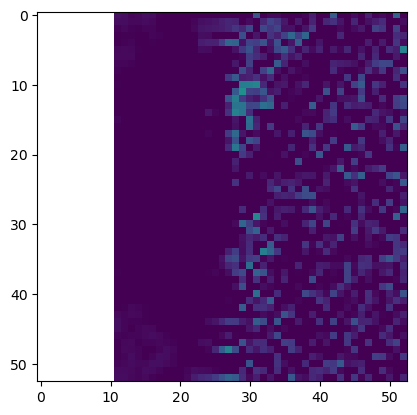

...

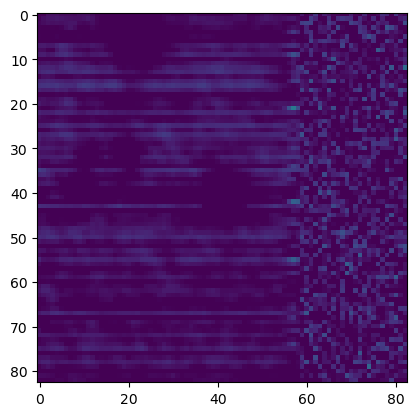

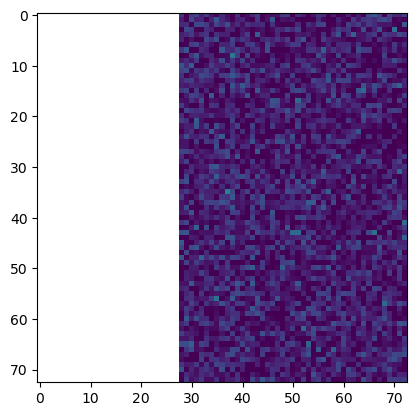

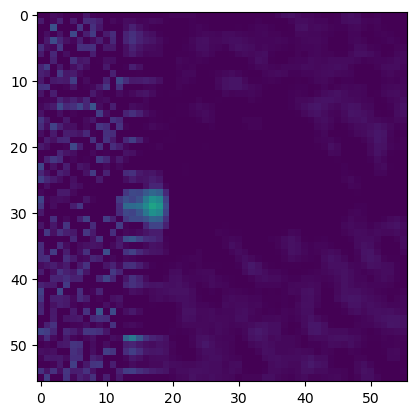

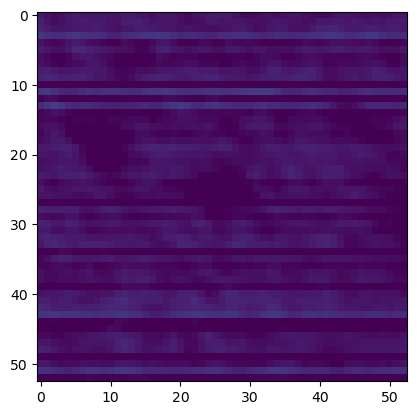

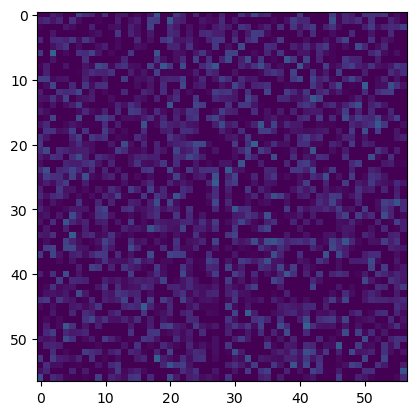

<Figure size 640x480 with 0 Axes>

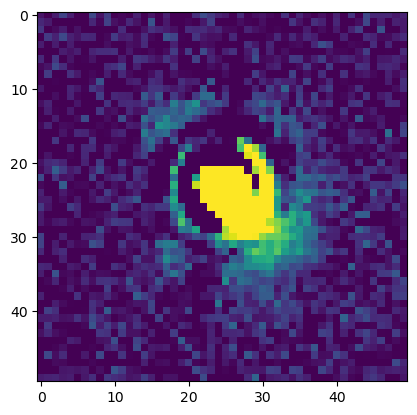

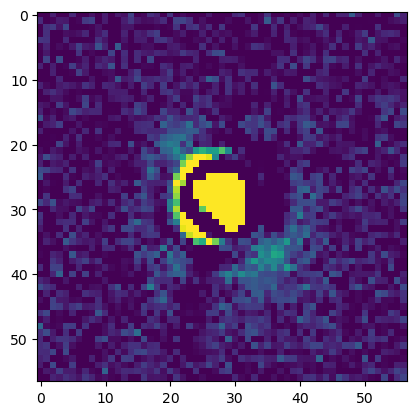

<Figure size 640x480 with 0 Axes>

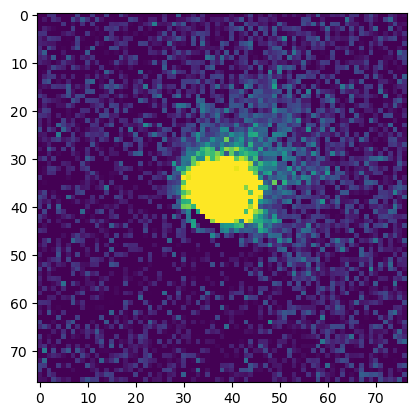

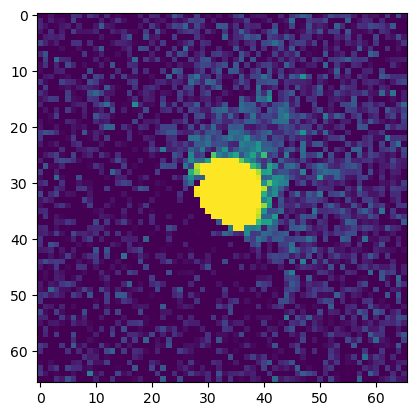

<Figure size 640x480 with 0 Axes>

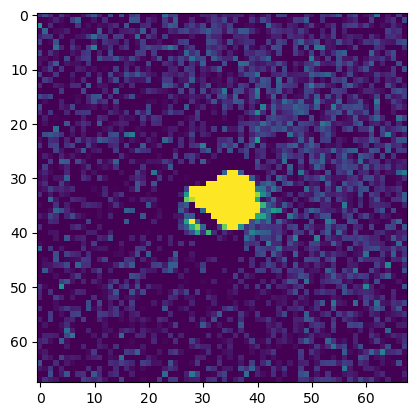

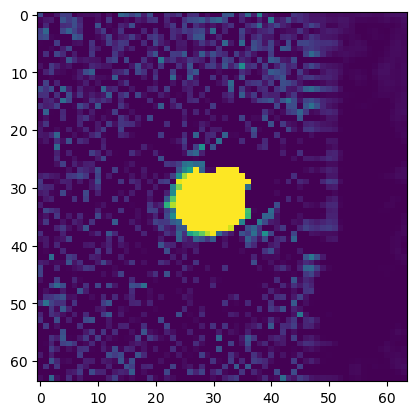

<Figure size 640x480 with 0 Axes>

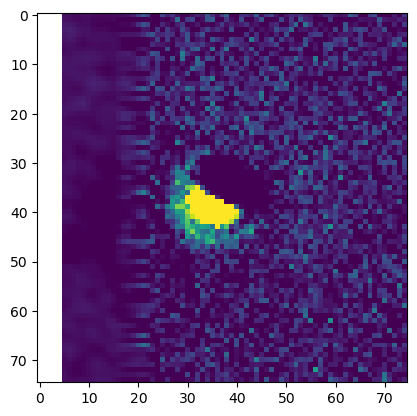

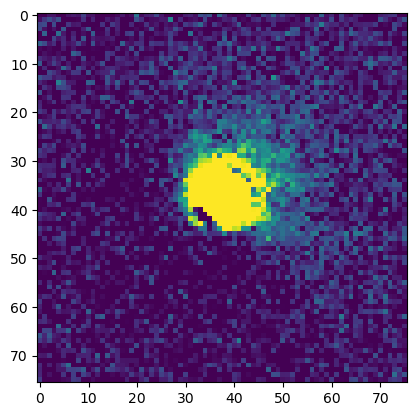

<Figure size 640x480 with 0 Axes>

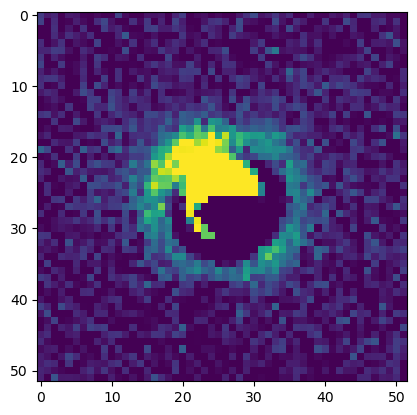

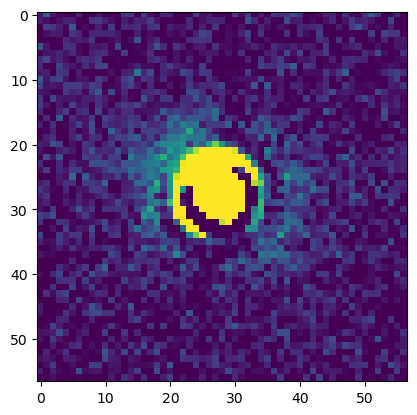

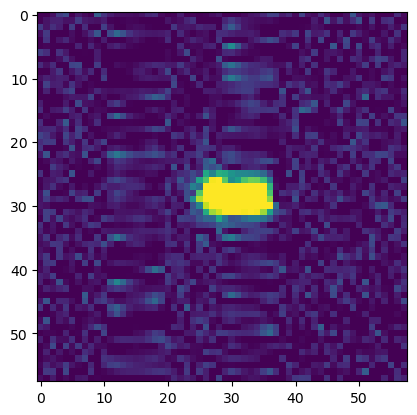

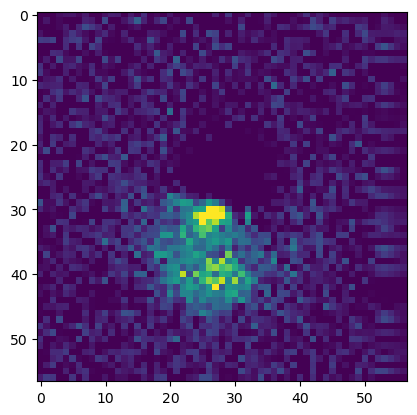

<Figure size 640x480 with 0 Axes>

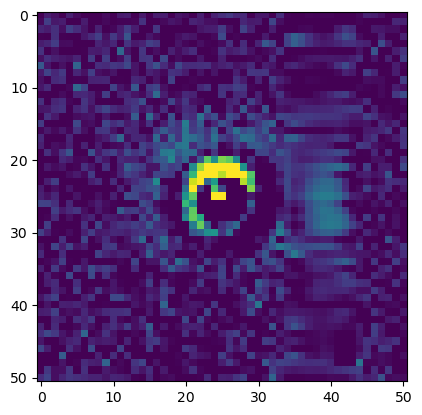

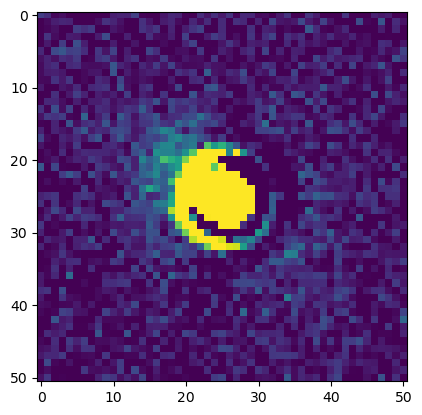

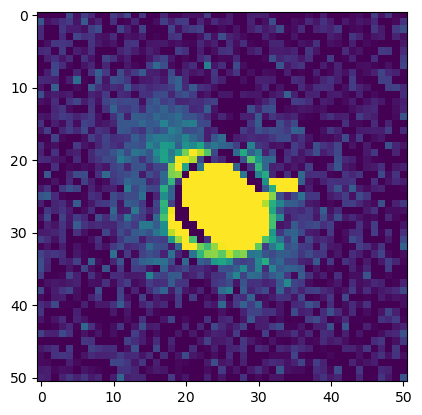

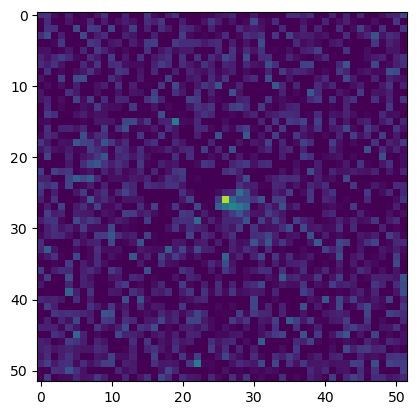

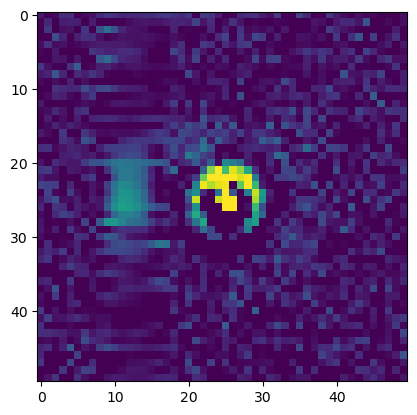

...

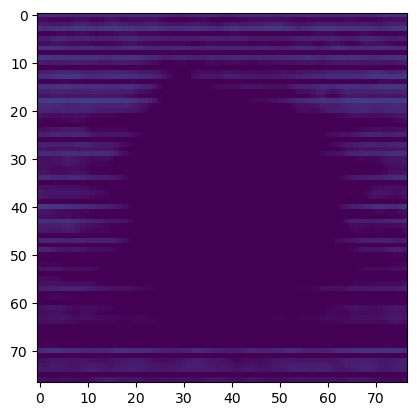

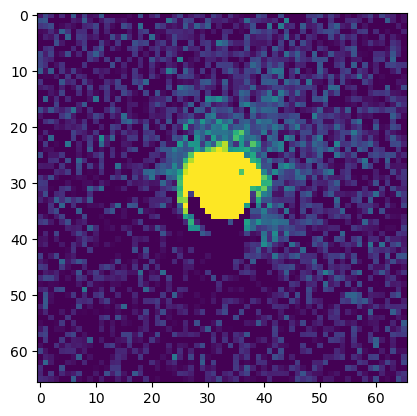

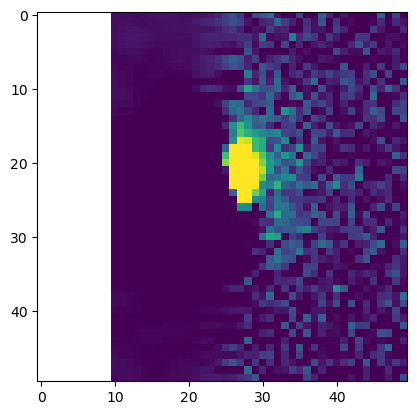

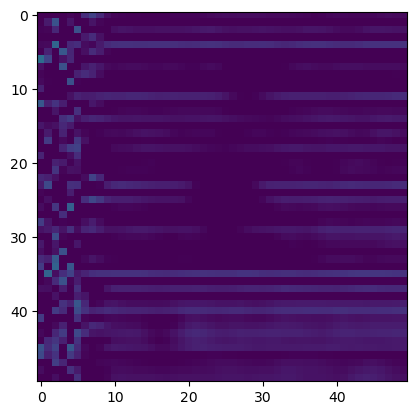

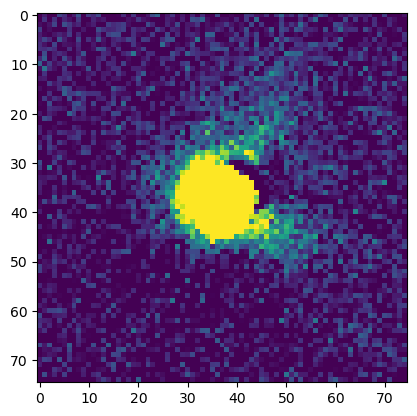

<Figure size 640x480 with 0 Axes>

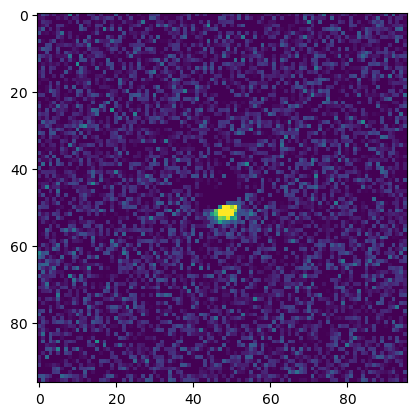

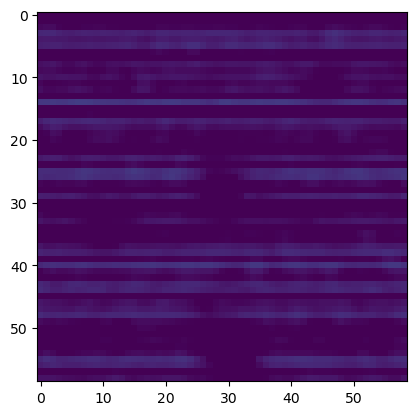

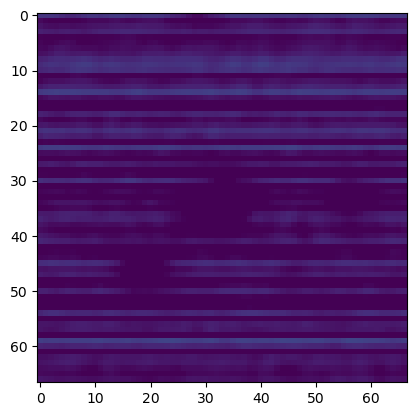

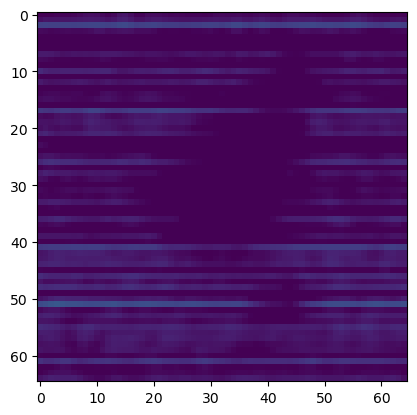

<Figure size 640x480 with 0 Axes>

In [49]:
files_gen = find_files('/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts')
if files_gen: # in case the generator is null
    while True:
        try:
            plot_stamps(next(files_gen), 100,50, sourceId=None)
        except StopIteration:
            break

## Extra scratchwork

source_found
Continue to plotting
plotting....
-----------------------------------------------
/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832043.avro
DiaSource Id:  25409118864933814
Bounding Box:  (214, 214)
Centroid:  1600.6063086766635 1941.9561393177312
Dipole Flux Flag:  True
Dipole Flux Centroid:  1600.6063086766635 1941.9561393177312
Seperation of x and y dipole coords:  [-1008.978515625, 90.1041259765625]


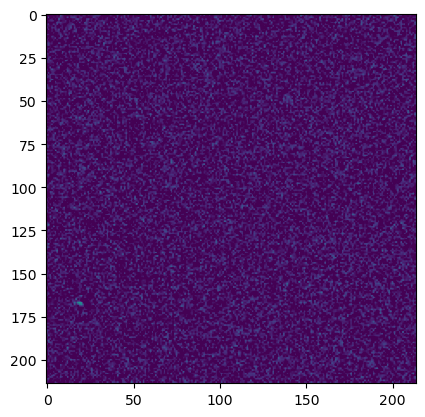

In [376]:
packet_filename='/home/s/smart/u/code/workspacest/postage_stamp_investigation/alerts/11832043.avro'
packet = plot_stamps(packet_filename, 1000,200, sourceId=25409118864933814)

In [349]:
                    #print(flag)
                    #source = apdbQuery.load_source(packet['diaSource']['diaSourceId'])
                    #dataId ={'detector':source['detector'],'visit': source['visit']}
                    #catalog = butler.get(f'goodSeeingDiff_diaSrc', dataId)
                    #record = catalog.find(packet['diaSource']['diaSourceId'])
                    # if flag is not None:
                    #    print("Fag Set")
                    #    source = apdbQuery.load_source(packet['diaSource']['diaSourceId'])
                    #    dataId ={'detector':source['detector'],'visit': source['visit']}
                    #    catalog = butler.get(f'goodSeeingDiff_diaSrc', dataId)
                    #    record = catalog.find(packet['diaSource']['diaSourceId'])
                    #    if record[flag] is not flag_bool:
                    #        print(record[flag])
                    #        #continue
                    #        out=1
                    #    else:
                    #        plt.figure()
                    #        print('-----------------------------------------------')
                    #        print(filename)
                    #        print("DiaSource Id: ", packet['diaSource']['diaSourceId'])
                    #        print("Bounding Box: ", bbox)
                    #        print("Centroid: ", record.getX(), record.getY())
                    #        print("Dipole Flux Flag: ", record['ip_diffim_PsfDipoleFlux_flag'])
                    #        print("Dipole Flux Centroid: ", record['ip_diffim_NaiveDipoleCentroid_x'],record['ip_diffim_NaiveDipoleCentroid_y'])
                    #        x_dipole_sep=record['ip_diffim_NaiveDipoleCentroid_pos_x']-record['ip_diffim_NaiveDipoleCentroid_neg_x']
                    #        y_dipole_sep=record['ip_diffim_NaiveDipoleCentroid_pos_y']-record['ip_diffim_NaiveDipoleCentroid_neg_y']
                    #        print("Seperation of x and y dipole coords: ", [x_dipole_sep,y_dipole_sep])
                    #        plt.imshow(cutoutFromBytes, vmin=-1, vmax=30)

                    #else: